## Initialisation

Visualise dataset from DB. 

First some technical initialisations. Kernel restart is needed after installations.

Do *not* work. GDAL fails because of libpopler and messes up all other installations as well.

In [ ]:
#!conda update -y -n base -c defaults conda
#!conda install -y -c conda-forge gdal regionmask

Packages to be added to remote dask: rasterio[s3] xarray shapey

In [2]:
!pip install --upgrade pip
!pip uninstall -y enum34
!pip install --upgrade numpy==1.18.1 pyzmq xarray pyproj pandas shapely geopandas dask_ml joblib scikit-learn==0.22.2.post1 dask[dataframe]==2.12.0 distributed==2.12.0 lz4==3.0.2 blosc==1.8.3 cloudpickle==1.3.0 msgpack==1.0.0 toolz==0.10.0 tornado==6.0.4 imbalanced-learn rasterio[s3] blosc==1.8.3 dask_ml msgpack==1.0.0

    100% |████████████████████████████████| 1.5MB 20.8MB/s ta 0:00:01
  Found existing installation: pip 10.0.1
    Uninstalling pip-10.0.1:
      Successfully uninstalled pip-10.0.1
Found existing installation: enum34 1.1.9
Uninstalling enum34-1.1.9:
  Successfully uninstalled enum34-1.1.9
     |████████████████████████████████| 20.1 MB 10.1 MB/s eta 0:00:01
     |████████████████████████████████| 1.1 MB 67.7 MB/s eta 0:00:01
     |████████████████████████████████| 668 kB 60.6 MB/s eta 0:00:01
     |████████████████████████████████| 10.9 MB 49.8 MB/s eta 0:00:01
     |████████████████████████████████| 10.0 MB 47.1 MB/s eta 0:00:01
     |████████████████████████████████| 1.8 MB 47.1 MB/s eta 0:00:01
     |████████████████████████████████| 928 kB 62.6 MB/s eta 0:00:01
     |████████████████████████████████| 124 kB 66.4 MB/s eta 0:00:01
     |████████████████████████████████| 294 kB 47.9 MB/s eta 0:00:01
     |████████████████████████████████| 7.1 MB 44.3 MB/s eta 0:00:01
     |█████████

In [2]:
import datetime, time, boto3, yaml, os
from datetime import timedelta

import pandas as pd
import numpy as np
from scipy.stats import pearsonr
from scipy import linalg

import geopandas as gpd
import rasterio
from shapely import wkt
from rasterio.plot import show
from rasterio.mask import mask
from rasterio.rio.clip import clip
from rasterio import features
import xarray as xr
#import regionmask
from shapely.geometry import Polygon, MultiPolygon

import psycopg2
from sqlalchemy import create_engine

from dask.distributed import Client, progress
import dask.dataframe as dd
import dask
from dask import delayed

from sagemaker import get_execution_role

import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import matplotlib.ticker as mticker
import matplotlib.patches as mpatches
from mpl_toolkits.axes_grid1 import make_axes_locatable
import seaborn as sns

from sklearn.covariance import GraphicalLassoCV, ledoit_wolf

sns.set()
sns.set_style("whitegrid")
%matplotlib inline

### Setting parameters

For loading data:

In [3]:
db_host = 'sasse-era5.cluster-czjuk16bite5.eu-west-1.rds.amazonaws.com'
db_port = 5432
db_name = "postgres"
db_user = "contour_rw"
db_pass = "hkatAmryqRbmWEsyZQVvuExm"
conf_bucket  ='fmi-sasse-cloudformation'
conf_file    = 'smartmet.yaml'
loiste_bbox  = '25,62.7,31.4,66.4'
sssoy_bbox   = '24.5,60,30.6,63.5'

Load params:

In [21]:
s3 = boto3.resource('s3')

#content_object = s3.Object(conf_bucket, conf_file)
with open('../cnf/smartmet.yaml') as conf_file:
    config_dict = yaml.safe_load(conf_file)
#file_content = content_object.get()['Body'].read().decode('utf-8')
#config_dict = yaml.load(file_content, Loader=yaml.FullLoader)

params = config_dict['params']
met_params = set()
shortnames = True
for param, info in params.items():
    for f in info['aggregation']:
        if shortnames:
            met_params.add(f[1:]+' '+info['name'])
        else:
            met_params.add(f+'{'+param+'}')
            
forest_params = config_dict['forest_params_db']
shortnames = True
for param, info in forest_params.items():
    for f in info['aggregation']:
        if shortnames:
            met_params.add(f[1:]+' '+info['name'])
        else:
            met_params.add(f+'{'+param+'}')
            

met_params = list(met_params)

Update polygon and meteorlogical params. Lists are used in process_polygons function and while saving the data to db.

In [22]:
polygon_params = ['speed_self', 'angle_self', 'area_m2', 'area_diff']
meta_params = ['id', 'storm_id', 'point_in_time', 'weather_parameter', 'low_limit', 'high_limit']
outage_params = ['outages', 'customers']
transformers_params = ['transformers', 'all_customers']

storm_params = polygon_params + met_params
all_params = meta_params + storm_params + outage_params

Functions to load dataset (used later)

In [12]:
def load_dataset(table_name='classification_dataset_loiste_jse_forest'):
    """
    Load classification dataset from db
    
    table_name : str
                 table name to be used
    """
    all_params_w_labels = all_params + ['class', 'class_customers']
    conn = psycopg2.connect("dbname='%s' user='%s' host='%s' password='%s'" % (db_name, db_user, db_host, db_pass))
    sql = """SELECT "{}" FROM sasse.{}""".format('","'.join(all_params_w_labels), table_name)

    cursor = conn.cursor()
    cursor.execute(sql)
    results = cursor.fetchall()
    df = pd.DataFrame(results, columns=all_params_w_labels)
    df.set_index('point_in_time', inplace=True)
    return df    

## Analysis

### Loiste & JSE

Load ready dataset from database:

#### Load data

In [23]:
dataset = load_dataset()

In [27]:
df = dataset.copy()

#### Number of different types of polygons

Number of different types of polygons:

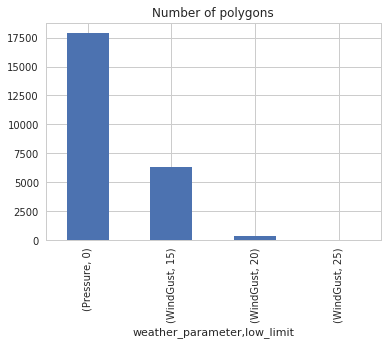

In [28]:
df.groupby(by=['weather_parameter', 'low_limit']).count()['id'].plot(kind='bar', title='Number of polygons')

In [29]:
df.groupby(by=['weather_parameter', 'low_limit']).count()['id']

weather_parameter  low_limit
Pressure           0            17865
WindGust           15            6333
                   20             336
                   25               8
Name: id, dtype: int64

#### Histogram of outage count

Number of outages caused by the storms.

In [30]:
df.groupby(by=['outages']).count()['id']

outages
0      22179
1       1490
2        383
3        166
4         94
5         40
6         44
7         38
8         18
9         14
10        11
11        13
12         7
13         4
14         6
15         2
16         4
17         2
18         1
19         2
20         1
23         2
26         1
27         1
28         1
32         1
33         2
34         1
37         1
39         1
40         1
41         1
42         3
43         1
55         1
58         1
60         1
75         1
83         1
114        1
Name: id, dtype: int64

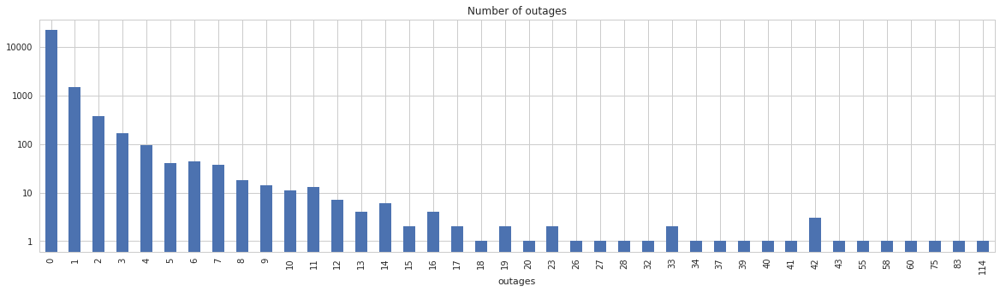

In [31]:
fig, ax = plt.subplots(figsize=(20,5))
df.groupby(by=['outages']).count()['id'].plot(kind='bar', title='Number of outages', ax=ax)
plt.yscale('log')
ax.yaxis.set_major_formatter(mticker.ScalarFormatter())
ax.yaxis.get_major_formatter().set_scientific(False)

#### Class sizes

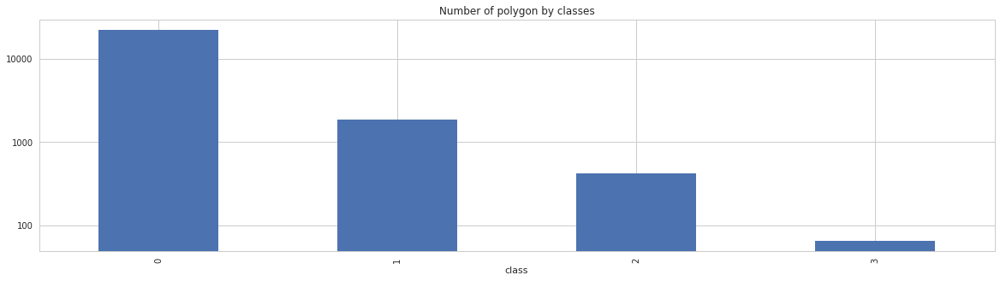

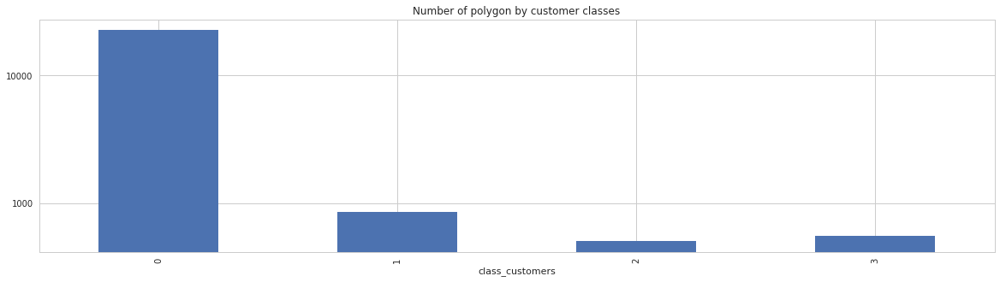

In [32]:
fig, ax = plt.subplots(figsize=(20,5))
df.groupby(by=['class']).count()['id'].plot(kind='bar', title='Number of polygon by classes', ax=ax)
plt.yscale('log')
ax.yaxis.set_major_formatter(mticker.ScalarFormatter())
ax.yaxis.get_major_formatter().set_scientific(False)

fig, ax = plt.subplots(figsize=(20,5))
df.groupby(by=['class_customers']).count()['id'].plot(kind='bar', title='Number of polygon by customer classes', ax=ax)
plt.yscale('log')
ax.yaxis.set_major_formatter(mticker.ScalarFormatter())
ax.yaxis.get_major_formatter().set_scientific(False)

#### Class Distribution

From above plots we can see that most of the polygons cause only 1 outage. It is notable that because reason of outages are not saved reliably, this bin may include a lot of noise. Outages are always reported from transformers. Second and third plot help us to give sense how many customers (namely houses) each outage means. 

First, if number of outages is 0, the class is 0. Rest of the dataset could be divided to classes following: 

Class 1:  1 - 2  outages  --> max ~50 customers without electricity<br>
Class 2:  3 - 10 outages  --> max ~250 customers without electricity <br>
Class 3: 11 -    outages  --> lots of customers without electricity<br>

We can also classify the data based on number of customers respectively:. 

Class 1:   1 - 250 cusomters  --> max ~2 outages<br>
Class 2: 251 - 500 customers  --> max ~10 outages <br>
Class 3: 501 -     customers  --> lots of outages<br>

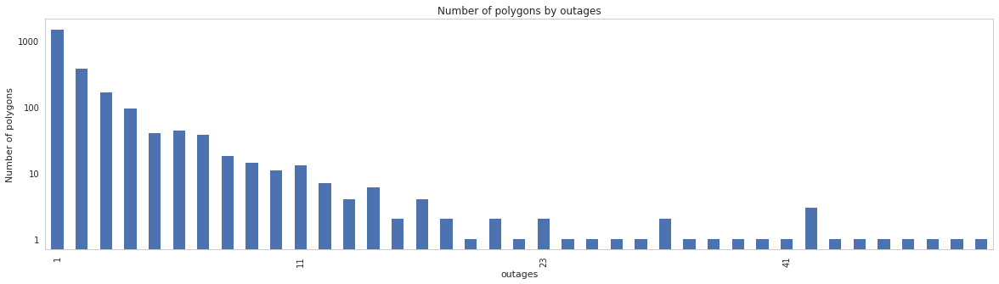

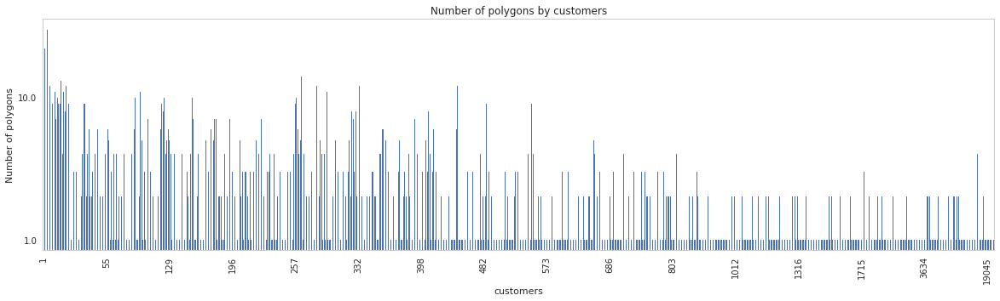

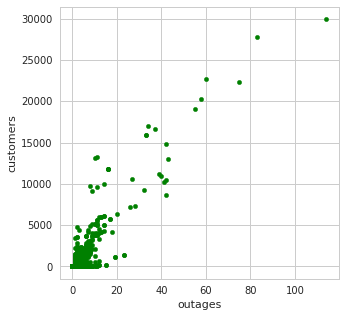

In [25]:
every_nth = 10
# Per transformer
fig, ax = plt.subplots(figsize=(20,5))
dataset.loc[(dataset['outages'] >= 1), :].groupby(by=['outages']).count()['id'].plot(kind='bar', title='Number of polygons by outages')
for n, label in enumerate(ax.xaxis.get_ticklabels()):
    if n % every_nth != 0:
        label.set_visible(False)
ax.set_yscale('log')
ax.yaxis.set_major_formatter(mticker.ScalarFormatter())

plt.ylabel('Number of polygons')
plt.grid(False)

# Per customer
fig, ax = plt.subplots(figsize=(20,5))
dataset.loc[(dataset['customers'] >= 1), :].groupby(by=['customers']).count()['id'].plot(kind='bar', title='Number of polygons by customers')
xtick_count = 15
every_nth = len(ax.xaxis.get_ticklabels()) // xtick_count
ax.set_yscale('log')
ax.yaxis.set_major_formatter(mticker.ScalarFormatter())
for n, label in enumerate(ax.xaxis.get_ticklabels()):
    if n % every_nth != 0:
        label.set_visible(False)
        
plt.ylabel('Number of polygons')
plt.grid(False)

# Scatter
fig, ax = plt.subplots(figsize=(5,5))
dataset.plot(kind='scatter', x='outages', y='customers', ax=ax, c='green')

#### Timeseries of storms and outages

Storm objects cause some outages. It can be seen from a timeseries of storm objects and outages as well.

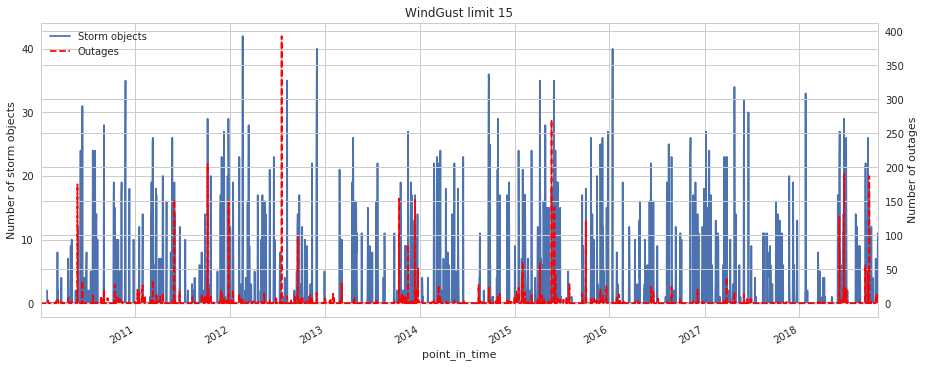

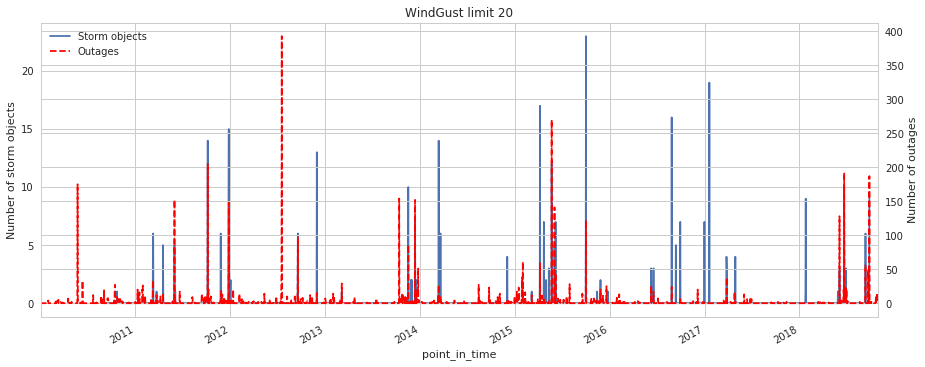

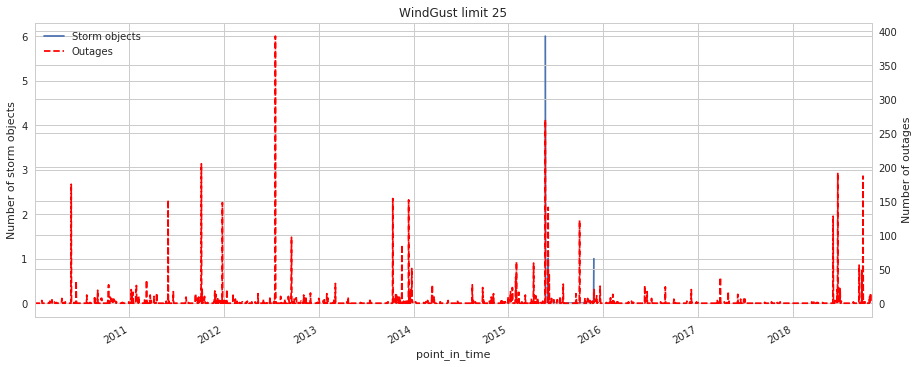

In [33]:
def plot_outages(df, parameter, limit):

    fig, ax = plt.subplots(figsize=(15,6))
    ax2 = ax.twinx()
    df[(df.loc[:,'weather_parameter'] == parameter) & (df.loc[:,'low_limit'] == limit)].loc[:,'weather_parameter'].groupby(by=[pd.Grouper(freq='D')]).count().plot(ax=ax, label='Storm objects')
    df.loc[:, 'outages'].groupby(by=[pd.Grouper(freq='D')]).sum().plot(ax=ax2, color='r', linestyle='dashed', label='Outages')
    fig.autofmt_xdate()

    ax.set_ylabel('Number of storm objects')
    ax2.set_ylabel('Number of outages')

    h1, l1 = ax.get_legend_handles_labels()
    h2, l2 = ax2.get_legend_handles_labels()
    ax.legend(h1+h2, l1+l2, loc='upper left')            
    
    plt.title('{} limit {}'.format(parameter, limit))
    
plot_outages(df, 'WindGust', 15)
plot_outages(df, 'WindGust', 20)
plot_outages(df, 'WindGust', 25)

#### Correlation between storms and outages

Correlation between storm objects and number of outages. Strong correlation exists.

In [34]:
def plot_pval(corr_df, ax):

    coeffmat = np.zeros((corr_df.shape[1], corr_df.shape[1]))
    pvalmat = np.zeros((corr_df.shape[1], corr_df.shape[1]))

    for i in range(corr_df.shape[1]):
        for j in range(corr_df.shape[1]):        
            corrtest = pearsonr(corr_df[corr_df.columns[i]], corr_df[corr_df.columns[j]])  

            coeffmat[i,j] = corrtest[0]
            pvalmat[i,j] = corrtest[1]

    pvalmat_df = pd.DataFrame(pvalmat, columns=corr_df.columns, index=corr_df.columns)
    #fig, ax = plt.subplots(figsize=(6,6))
    sns.heatmap(pvalmat_df, cmap="YlGnBu", annot=True, ax=ax)
    
def plot_corr(df):
    s = df[(df.loc[:,'weather_parameter'] == 'Pressure')].loc[:,'weather_parameter'].groupby(by=[pd.Grouper(freq='D')]).count()
    s2 = df[(df.loc[:,'weather_parameter'] == 'WindGust') & (df.loc[:,'low_limit'] == 15)].loc[:,'weather_parameter'].groupby(by=[pd.Grouper(freq='D')]).count()
    s3 = df[(df.loc[:,'weather_parameter'] == 'WindGust') & (df.loc[:,'low_limit'] == 20)].loc[:,'weather_parameter'].groupby(by=[pd.Grouper(freq='D')]).count()
    s4 = df[(df.loc[:,'weather_parameter'] == 'WindGust') & (df.loc[:,'low_limit'] == 25)].loc[:,'weather_parameter'].groupby(by=[pd.Grouper(freq='D')]).count()
    s5 = df.loc[:, 'outages'].groupby(by=[pd.Grouper(freq='D')]).sum()
    corr_df = pd.concat([s, s2, s3, s4, s5], axis=1, 
                        keys = ['Pressure', 'Wind Gust 15 m/s', 'Wind Gust 20 m/s', 'Wind Gust 25 m/s', 'Nro Outages'])
    corr_df.fillna(0, inplace=True)
    corr = corr_df.corr('pearson')

    fig, axes = plt.subplots(1, 2, figsize=(12,6))
    sns.heatmap(corr, cmap="YlGnBu", annot=True, ax=axes[0])
    axes[0].set_title('Correlation matrix')
    
    plot_pval(corr_df, ax=axes[1])
    axes[1].set_title('P-value test')
    plt.tight_layout()

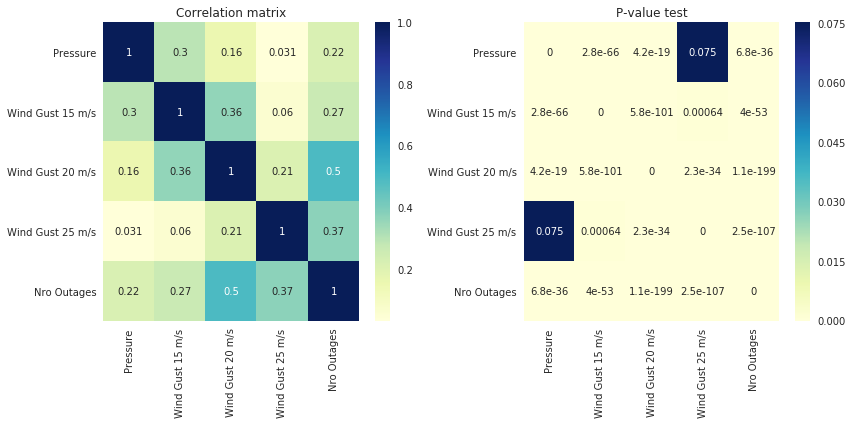

In [35]:
plot_corr(df)

#### Correlation between weather parameters and outages

Correlation between outages and different weather parameters (see two last rows). Significant correlation exists with at least: speed, area, temperature, standard deviation of the wind speed, total column water vapor, mixed layer height, CAPE, Dewpoint, total cloud cover, wind gust and pressure.

At least CAPE is most probably related to convective weather. 

P-value test passes for all parameters.

/home/ec2-user/anaconda3/envs/python3/lib/python3.6/site-packages/scipy/stats/stats.py:3010: RuntimeWarning: invalid value encountered in double_scalars
  r = r_num / r_den


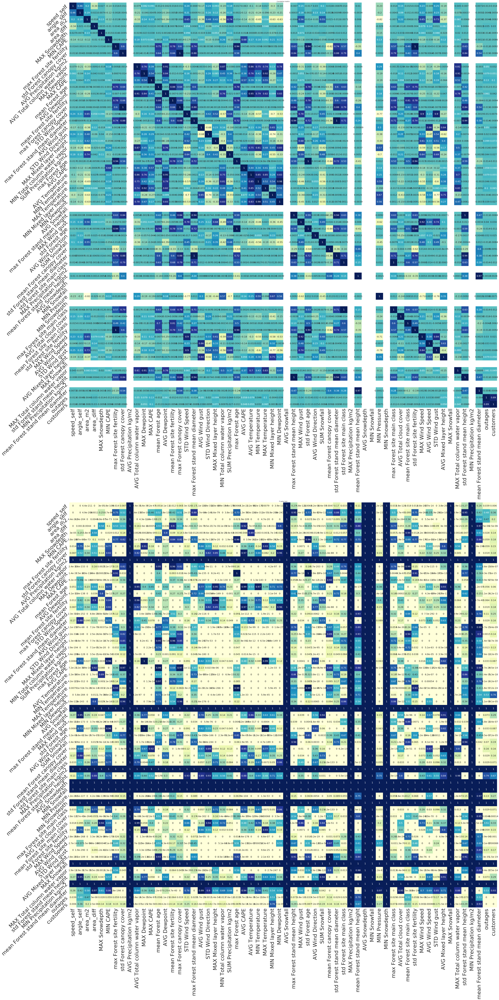

In [36]:
def plot_pval_(corr_df, ax):

    coeffmat = np.zeros((corr_df.shape[1], corr_df.shape[1]))
    pvalmat = np.zeros((corr_df.shape[1], corr_df.shape[1]))

    for i in range(corr_df.shape[1]):
        for j in range(corr_df.shape[1]):        
            corrtest = pearsonr(corr_df[corr_df.columns[i]], corr_df[corr_df.columns[j]])  

            coeffmat[i,j] = corrtest[0]
            pvalmat[i,j] = corrtest[1]

    pvalmat_df = pd.DataFrame(pvalmat, columns=corr_df.columns, index=corr_df.columns)
    g = sns.heatmap(pvalmat_df, cmap="YlGnBu", annot=True, ax=ax, annot_kws={"size": 20}, cbar=False)
    g.set_xticklabels(g.get_xmajorticklabels(), fontsize=45)
    g.set_yticklabels(g.get_ymajorticklabels(), fontsize=45, rotation=45)
    
df2 = df.loc[:, storm_params + outage_params].fillna(0)
corr = df2.corr('pearson')

#fig, axes = plt.subplots(1, 2, figsize=(45,30))
fig, axes = plt.subplots(2, 1, figsize=(60,120))
g = sns.heatmap(corr, cmap="YlGnBu", annot=True, ax=axes[0], annot_kws={"size": 20}, cbar=False)
g.set_xticklabels(g.get_xmajorticklabels(), fontsize=45)
g.set_yticklabels(g.get_ymajorticklabels(), fontsize=45, rotation=45)
axes[0].set_title('Correlation matrix')

plot_pval_(df2, ax=axes[1])
axes[1].set_title('P-value test')
plt.tight_layout()

Let's consider only winter months (from beginning of October to end of January). Now we don't have significant correlation between CAPE and outages but we do have much stronger correlation between most other parameters. Distance to pressure object and wind speed introduce also a significant correlation with outages.

P-value test do not pass for several parameter any more, however. We have much less data (826 rows).

/home/ec2-user/anaconda3/envs/python3/lib/python3.6/site-packages/scipy/stats/stats.py:3010: RuntimeWarning: invalid value encountered in double_scalars
  r = r_num / r_den


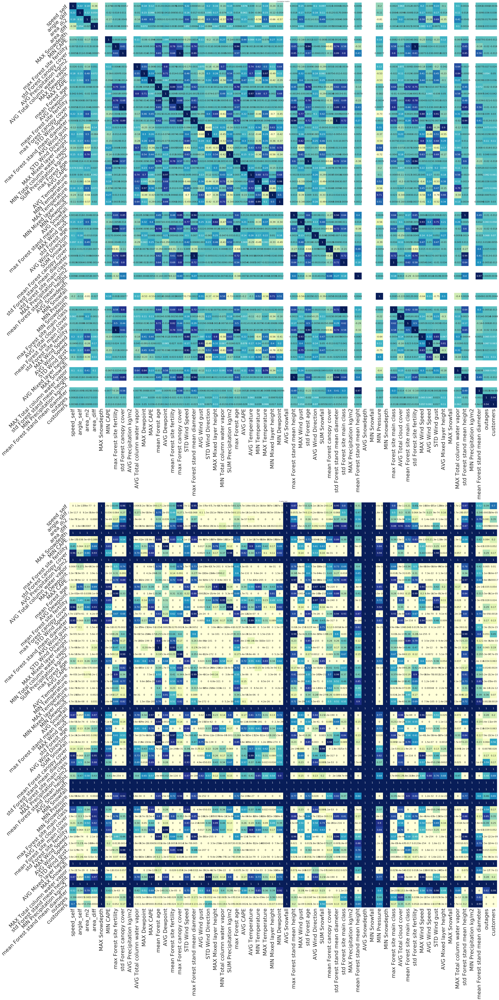

In [37]:
df3 = df.loc[(df.index.month >= 10) | (df.index.month <= 1), storm_params + outage_params].fillna(0)
corr = df3.corr('pearson')

#fig, axes = plt.subplots(1, 2, figsize=(45,30))
fig, axes = plt.subplots(2, 1, figsize=(60,120))
g = sns.heatmap(corr, cmap="YlGnBu", annot=True, ax=axes[0], annot_kws={"size": 20}, cbar=False)
g.set_xticklabels(g.get_xmajorticklabels(), fontsize=45)
g.set_yticklabels(g.get_ymajorticklabels(), fontsize=45, rotation=45)
axes[0].set_title('Correlation matrix')

plot_pval_(df3, ax=axes[1])
axes[1].set_title('P-value test')
plt.tight_layout()

#### Scatter plots of outages and weather parameters

Scatter plot for outages with each parameters:

In [43]:
def scatter_outages(df):
    rowcount = (int)(len(storm_params)/3)+1
    fig, axes = plt.subplots(rowcount, 3, figsize=(30,90))
    row, col, i = 0, 0, 0
    for p in storm_params:
        row = int(i/3)
        col = i%3
        tdf = df.loc[(df[p] != -999), ['outages', p]].astype(float)
        tdf.plot(kind='scatter', x='outages', y=p, c='g', ax=axes[row][col])
        i += 1

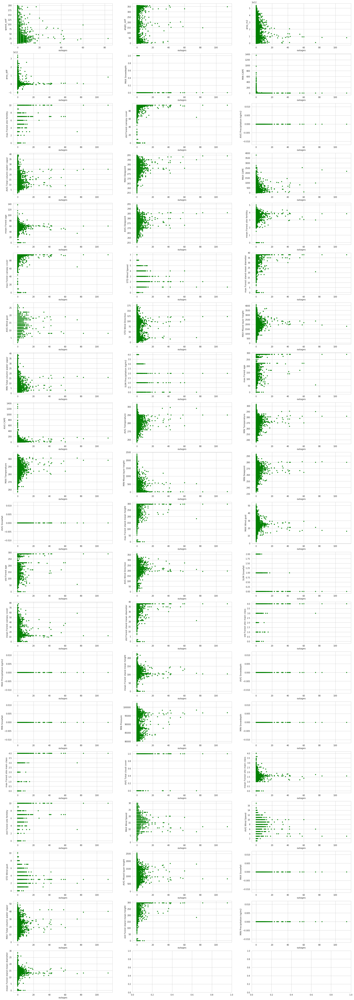

In [45]:
scatter_outages(df)

And the same for the winter months:

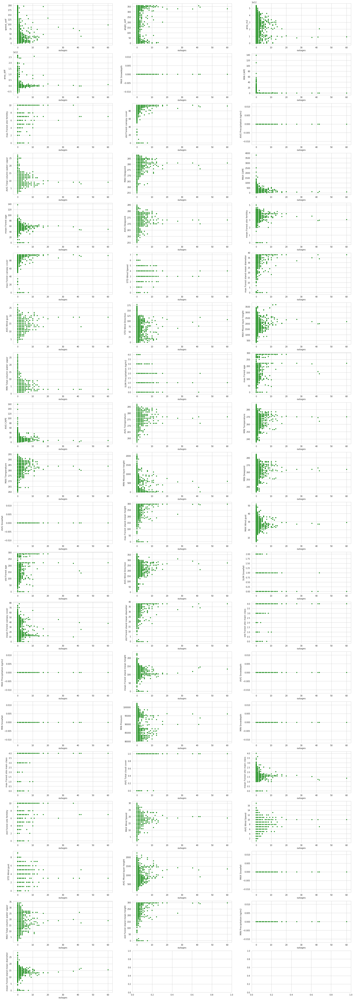

In [46]:
scatter_outages(df3)

### Energiateollisuus

#### Load dataset

Load ready dataset from database:

In [48]:
ene_dataset = load_dataset(table_name='classification_dataset_energiateollisuus_forest')

In [49]:
df = ene_dataset.copy()

#### Number of different types of polygons

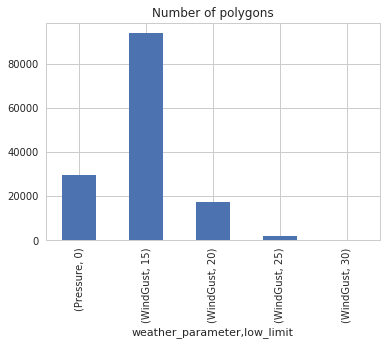

In [50]:
df.groupby(by=['weather_parameter', 'low_limit']).count()['id'].plot(kind='bar', title='Number of polygons')

In [51]:
df.groupby(by=['weather_parameter', 'low_limit']).count()['id']

weather_parameter  low_limit
Pressure           0            29690
WindGust           15           93717
                   20           17240
                   25            1988
                   30             238
Name: id, dtype: int64

#### Histogram of outage count

Number of outages caused by the storms.

In [52]:
print(df.groupby(by=['outages']).count()['id'].head())
print('[...]')
print(df.groupby(by=['outages']).count()['id'].tail())

outages
0    109074
1      6589
2      3232
3      1968
4      1275
Name: id, dtype: int64
[...]
outages
14873    2
14936    1
15248    3
15940    1
15989    2
Name: id, dtype: int64


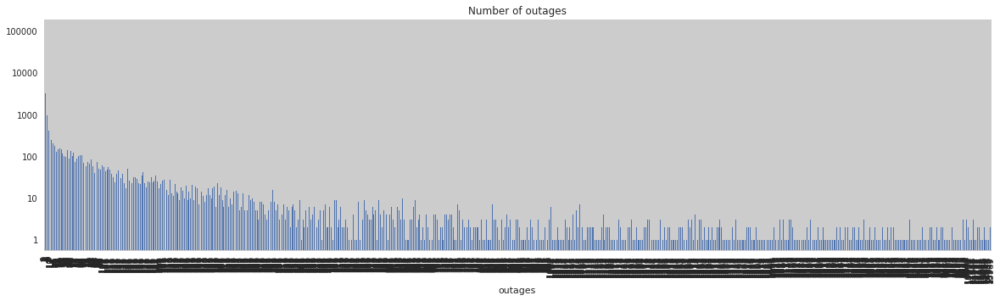

In [53]:
fig, ax = plt.subplots(figsize=(20,5))
df.groupby(by=['outages']).count()['id'].plot(kind='bar', title='Number of outages', ax=ax)
plt.yscale('log')
ax.yaxis.set_major_formatter(mticker.ScalarFormatter())
ax.yaxis.get_major_formatter().set_scientific(False)

#### Class sizes

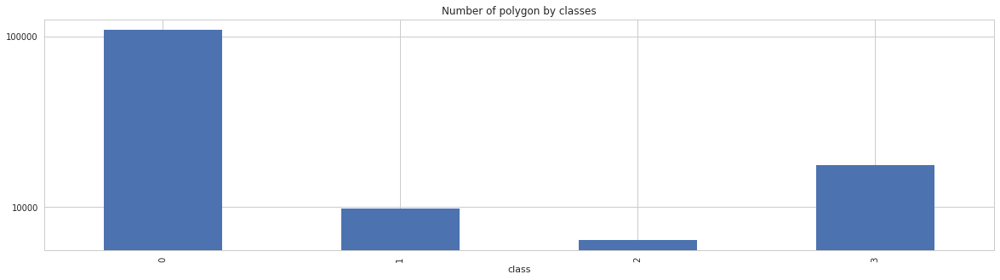

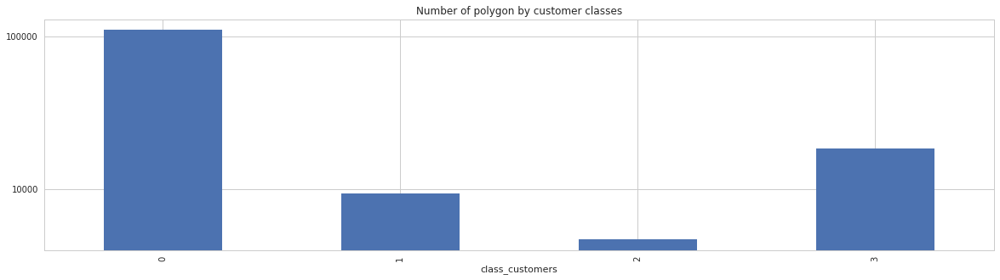

In [54]:
fig, ax = plt.subplots(figsize=(20,5))
df.groupby(by=['class']).count()['id'].plot(kind='bar', title='Number of polygon by classes', ax=ax)
plt.yscale('log')
ax.yaxis.set_major_formatter(mticker.ScalarFormatter())
ax.yaxis.get_major_formatter().set_scientific(False)

fig, ax = plt.subplots(figsize=(20,5))
df.groupby(by=['class_customers']).count()['id'].plot(kind='bar', title='Number of polygon by customer classes', ax=ax)
plt.yscale('log')
ax.yaxis.set_major_formatter(mticker.ScalarFormatter())
ax.yaxis.get_major_formatter().set_scientific(False)

Following plots help us to divide data to classes.

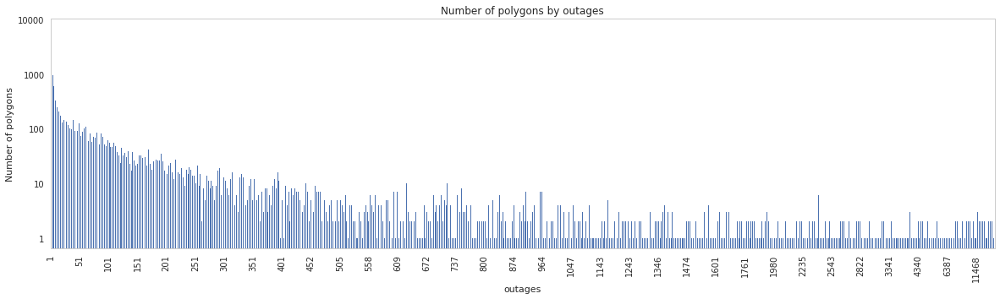

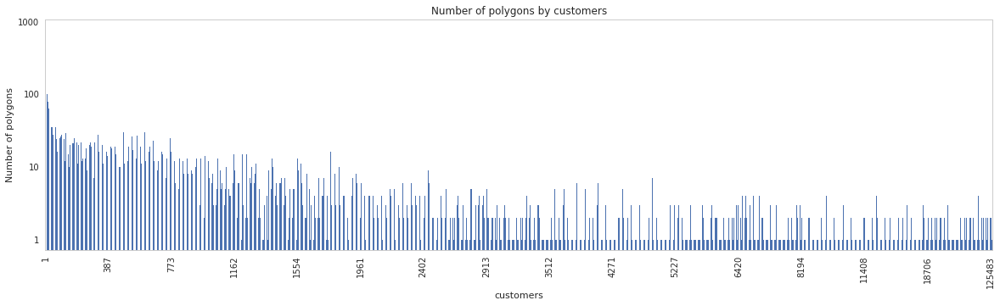

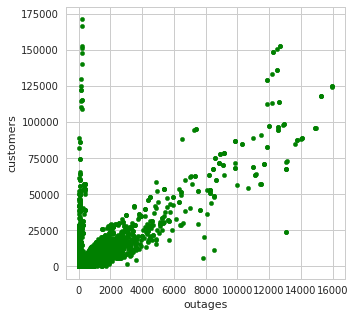

In [55]:
# Per transformer
fig, ax = plt.subplots(figsize=(20,5))
ene_dataset.loc[(ene_dataset['outages'] >= 1), :].groupby(by=['outages']).count()['id'].plot(kind='bar', title='Number of polygons by outages')
for n, label in enumerate(ax.xaxis.get_ticklabels()):
    if n % every_nth != 0:
        label.set_visible(False)
ax.set_yscale('log')
ax.yaxis.set_major_formatter(mticker.ScalarFormatter())

plt.ylabel('Number of polygons')
plt.grid(False)

# Per customer
fig, ax = plt.subplots(figsize=(20,5))
ene_dataset.loc[(ene_dataset['customers'] >= 1), :].groupby(by=['customers']).count()['id'].plot(kind='bar', title='Number of polygons by customers')
xtick_count = 15
every_nth = len(ax.xaxis.get_ticklabels()) // xtick_count
ax.set_yscale('log')
ax.yaxis.set_major_formatter(mticker.ScalarFormatter())
for n, label in enumerate(ax.xaxis.get_ticklabels()):
    if n % every_nth != 0:
        label.set_visible(False)
        
plt.ylabel('Number of polygons')
plt.grid(False)

# Scatter
fig, ax = plt.subplots(figsize=(5,5))
ene_dataset.plot(kind='scatter', x='outages', y='customers', ax=ax, c='green')

We can also scatter number of polygons against customers and outages.

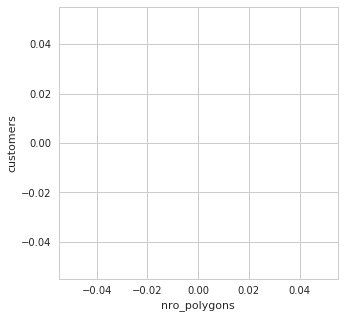

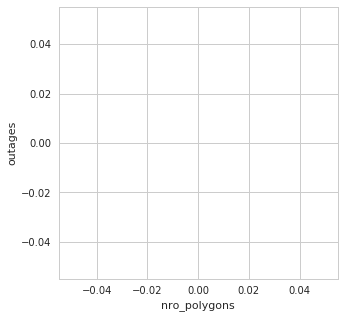

In [56]:
# Scatter
fig, ax = plt.subplots(figsize=(5,5))
df = pd.DataFrame(ene_dataset)
df['nro_polygons'] = df.loc[(df['outages'] >= 1), :].groupby(by=['outages']).count()['id']
df.plot(kind='scatter', x='nro_polygons', y='customers', ax=ax, c='green')
fig, ax = plt.subplots(figsize=(5,5))
df.plot(kind='scatter', x='nro_polygons', y='outages', ax=ax, c='green')

First, if number of outages is 0, the class is 0. Rest of the dataset could be divided to classes following (based on the first ploit): 

Class 1:   1 - 250  outages<br>
Class 2: 251 - 750  outages<br>
Class 3: 751 -      outages<br>

We can also classify the data based on number of customers respectively (based on the second plot): 

Class 1:    1 - 1000 customers<br>
Class 2: 1001 - 3000 customers<br>
Class 3: 3001 -      customers <br>

#### Timeseries of storms and outages

Storm objects cause some outages. It can be seen from a timeseries of storm objects and outages as well.

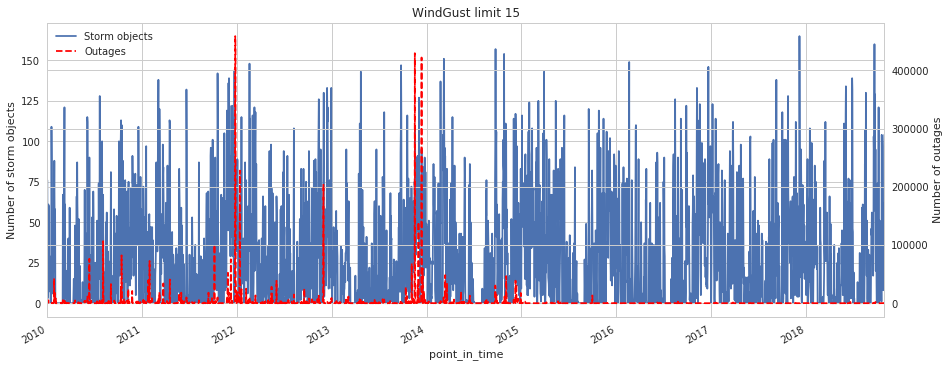

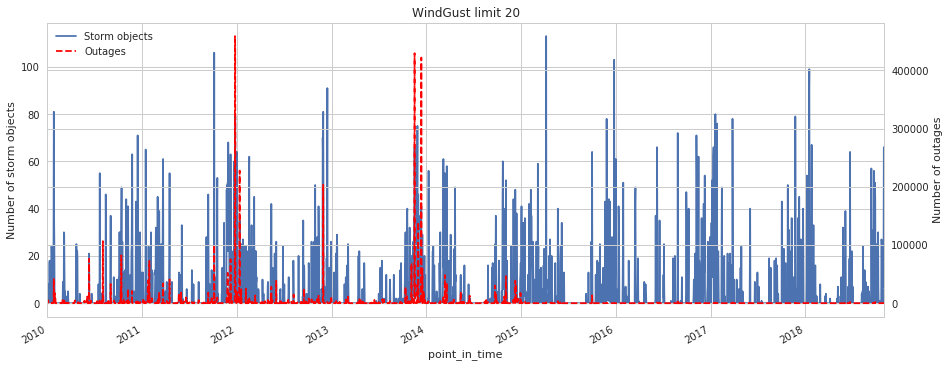

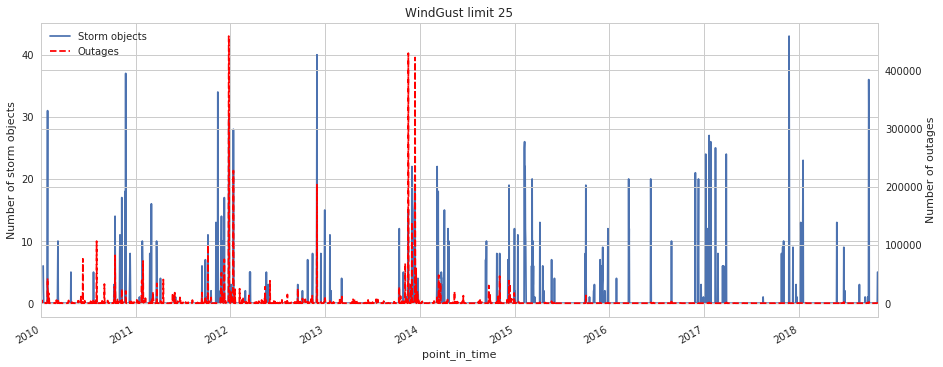

In [57]:
def plot_outages(df, parameter, limit):

    fig, ax = plt.subplots(figsize=(15,6))
    ax2 = ax.twinx()
    df[(df.loc[:,'weather_parameter'] == parameter) & (df.loc[:,'low_limit'] == limit)].loc[:,'weather_parameter'].groupby(by=[pd.Grouper(freq='D')]).count().plot(ax=ax, label='Storm objects')
    df.loc[:, 'outages'].groupby(by=[pd.Grouper(freq='D')]).sum().plot(ax=ax2, color='r', linestyle='dashed', label='Outages')
    fig.autofmt_xdate()

    ax.set_ylabel('Number of storm objects')
    ax2.set_ylabel('Number of outages')

    h1, l1 = ax.get_legend_handles_labels()
    h2, l2 = ax2.get_legend_handles_labels()
    ax.legend(h1+h2, l1+l2, loc='upper left')            
    
    plt.title('{} limit {}'.format(parameter, limit))
    
plot_outages(df, 'WindGust', 15)
plot_outages(df, 'WindGust', 20)
plot_outages(df, 'WindGust', 25)

#### Correlation between storms and outages

Correlation between storm objects and number of outages. Strong correlation exists.

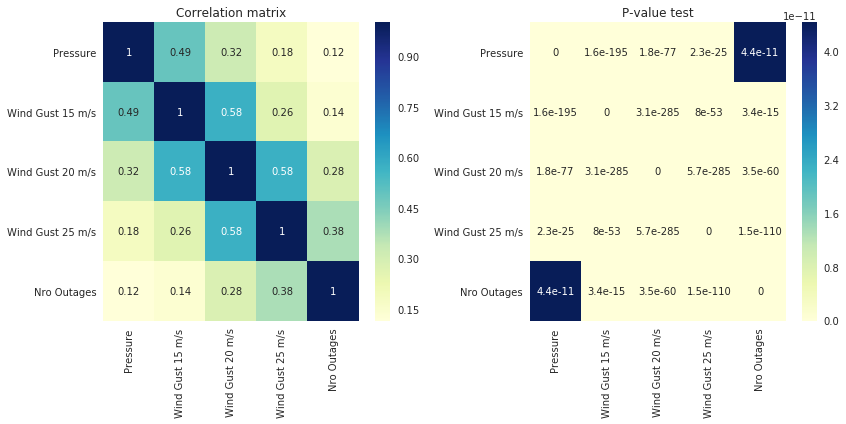

In [58]:
plot_corr(df) # Function defined in Loiste & JSE analysis

#### Correlation between weather parameters and outages

Correlation between outages and different weather parameters (see two last rows). Significant correlation exists with at least: area_m2, Max wind speed, STD Wind Speed, Max Wind Gust, STD Wind Gust, Max Precipitation kg/m2, SUM Precipitation KG/m2, Sum Snowfall, AVG Mixed layer height, Max Mixed layer height.

P-value test passes for all parameters having significant correlation except for Max precipitation kg/m2 (why?).

/home/ec2-user/anaconda3/envs/python3/lib/python3.6/site-packages/scipy/stats/stats.py:3010: RuntimeWarning: invalid value encountered in double_scalars
  r = r_num / r_den


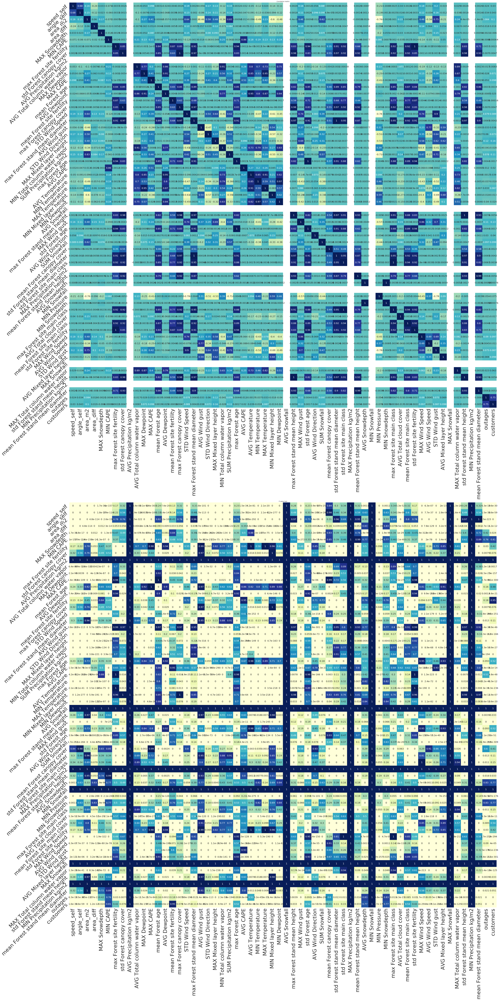

In [59]:
df2 = df.loc[:, storm_params + outage_params].fillna(0)
corr = df2.corr('pearson')

#fig, axes = plt.subplots(1, 2, figsize=(45,30))
fig, axes = plt.subplots(2, 1, figsize=(60,120))
g = sns.heatmap(corr, cmap="YlGnBu", annot=True, ax=axes[0], annot_kws={"size": 20}, cbar=False)
g.set_xticklabels(g.get_xmajorticklabels(), fontsize=45)
g.set_yticklabels(g.get_ymajorticklabels(), fontsize=45, rotation=45)
axes[0].set_title('Correlation matrix')

plot_pval_(df2, ax=axes[1]) # Function defined in Loiste & JSE Analysis
axes[1].set_title('P-value test')
plt.tight_layout()

Let's consider only winter months (from beginning of October to end of January). Correlations are same with whole dataset.

P-value test passes for all paratemers having significant correlation  except AVG windspeed (why?).

/home/ec2-user/anaconda3/envs/python3/lib/python3.6/site-packages/scipy/stats/stats.py:3010: RuntimeWarning: invalid value encountered in double_scalars
  r = r_num / r_den


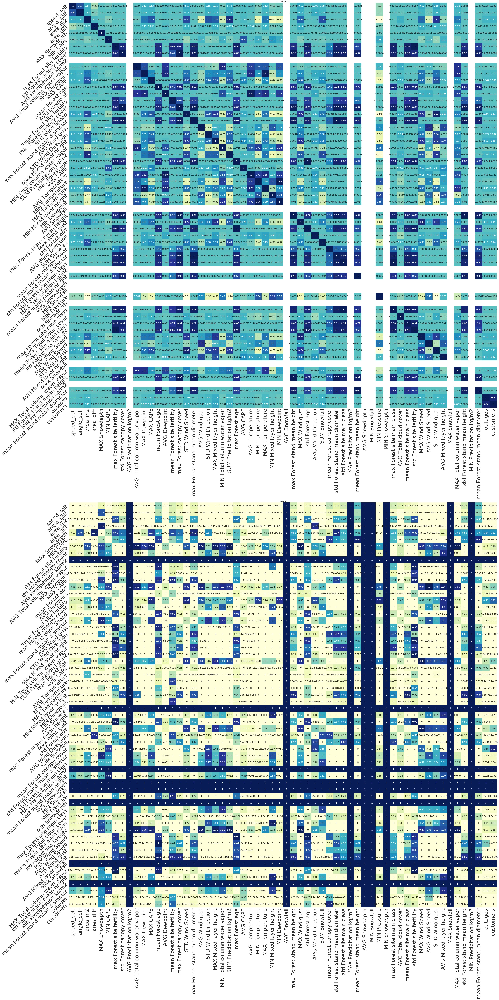

In [60]:
df3 = df.loc[(df.index.month >= 10) | (df.index.month <= 1), storm_params + outage_params].fillna(0)
corr = df3.corr('pearson')

#fig, axes = plt.subplots(1, 2, figsize=(45,30))
fig, axes = plt.subplots(2, 1, figsize=(60,120))
g = sns.heatmap(corr, cmap="YlGnBu", annot=True, ax=axes[0], annot_kws={"size": 20}, cbar=False)
g.set_xticklabels(g.get_xmajorticklabels(), fontsize=45)
g.set_yticklabels(g.get_ymajorticklabels(), fontsize=45, rotation=45)
axes[0].set_title('Correlation matrix')

plot_pval_(df3, ax=axes[1])
axes[1].set_title('P-value test')
plt.tight_layout()

#### Scatter plots of outages and weather parameters

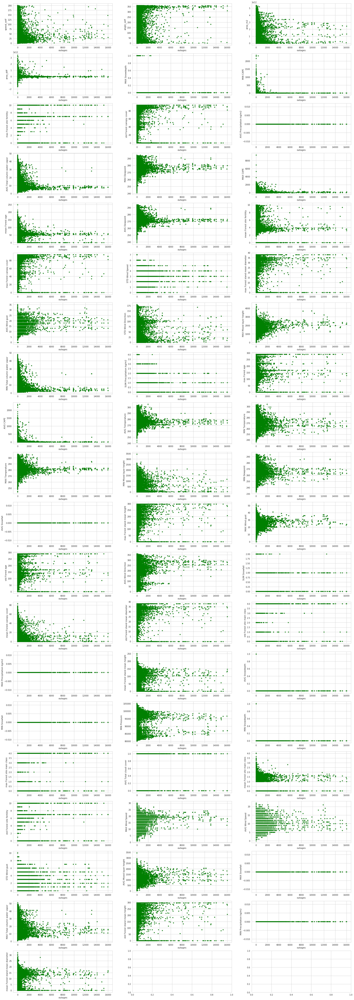

In [61]:
scatter_outages(df) # Function defined in Loiste & JSE analysis

And the same for the winter months:

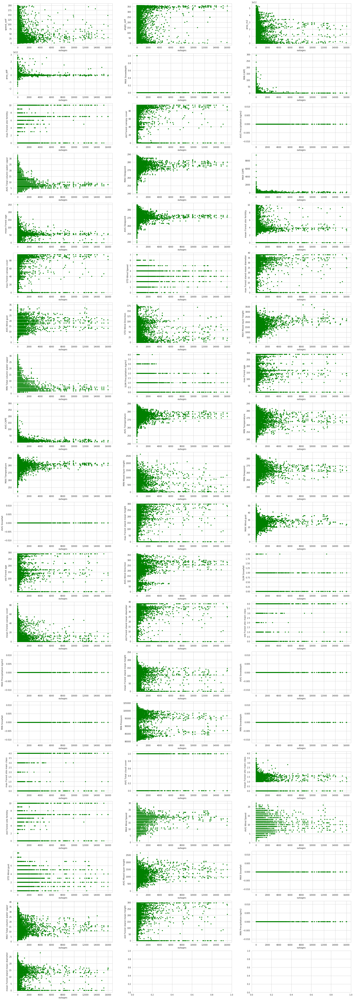

In [62]:
scatter_outages(df3)

#### Precision matrix

In [63]:
cov_data = df.loc[:, storm_params].dropna()

In [ ]:
gl = GraphicalLassoCV(cv=3, mode='cd')
gl.fit(cov_data.astype(np.float))

In [ ]:
cov_ = cov_data.cov()
prec_ = linalg.inv(cov_)

In [66]:
lw_cov_, _ = ledoit_wolf(cov_data.astype(np.float))
lw_prec_ = linalg.inv(lw_cov_)

In [67]:
def vis_covs(covs, param_list, title='covariance'):
    # plot the precisions
    plt.figure(figsize=(10, 10*len(covs)))
    for i, (name, this_prec) in enumerate(covs):
        params = param_list[i]
        ticks = np.arange(0.5, len(params)+.5, 1)
        y_ticks = list(ticks)
        y_ticks.reverse()
        minor_ticks = np.arange(0, len(params), 1)
        
        vmax = .9 * this_prec.max()
        ax2 = plt.subplot(len(precs), 1, i + 1)
        im = plt.imshow(this_prec, 
                        extent=(0, len(params), 0, len(params)),
                        vmin=-vmax, vmax=vmax,
                        cmap="bwr", 
                        aspect='equal')

        plt.xticks(ticks=ticks, labels=params, rotation=90)
        plt.yticks(ticks=y_ticks, labels=params)
        ax2.set_xticks(minor_ticks, minor=True)
        ax2.set_yticks(minor_ticks, minor=True)

        plt.title('{} {}'.format(name, title))
        ax2.set_facecolor('.7')
        ax2.grid(which='minor', color='black', linestyle='--', linewidth=.2)        
        ax2.grid(False, which='major')

        divider = make_axes_locatable(ax2)
        cax2 = divider.append_axes("right", size="5%", pad=0.05)
        plt.colorbar(ax=ax2, cax=cax2)

    plt.tight_layout()
    plt.show()

In [ ]:
covs = [('Ledoit-Wolf', lw_cov_),
        #('GraphicalLassoCV', gl.covariance_),
        #('True', cov_.values)
        ]
precs = [('Ledoit-Wolf', lw_prec_),
         #('GraphicalLasso', gl.precision_), 
         #('True', prec_)
        ]
params = [storm_params, cov_.columns]
#vis_cov_prec(covs, precs, params)
vis_covs(covs, params)
vis_covs(precs, params, 'precision')